In [7]:
!! pip install Pillow
!! pip install imageio
!! pip install imageio[ffmpeg]

['Requirement already satisfied: imageio[ffmpeg] in c:\\users\\lenovo\\appdata\\local\\programs\\python\\python311\\lib\\site-packages (2.31.1)',
 'Requirement already satisfied: numpy in c:\\users\\lenovo\\appdata\\local\\programs\\python\\python311\\lib\\site-packages (from imageio[ffmpeg]) (1.23.5)',
 'Requirement already satisfied: pillow>=8.3.2 in c:\\users\\lenovo\\appdata\\local\\programs\\python\\python311\\lib\\site-packages (from imageio[ffmpeg]) (9.5.0)',
 'Collecting imageio-ffmpeg (from imageio[ffmpeg])',
 '  Downloading imageio_ffmpeg-0.4.8-py3-none-win_amd64.whl (22.6 MB)',
 '     ---------------------------------------- 0.0/22.6 MB ? eta -:--:--',
 '     ---------------------------------------- 0.0/22.6 MB ? eta -:--:--',
 '     ---------------------------------------- 0.0/22.6 MB ? eta -:--:--',
 '     ---------------------------------------- 0.0/22.6 MB ? eta -:--:--',
 '     ---------------------------------------- 0.0/22.6 MB ? eta -:--:--',
 '     -----------------

C:\Users\lenovo\AppData\Local\Temp\ipykernel_11864\625410686.py:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(image_path)


(1024, 8704, 3)


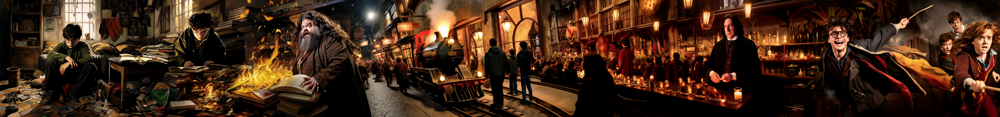

In [18]:
import imageio.v2
from PIL import Image, ImageFile

# Load the image
ImageFile.LOAD_TRUNCATED_IMAGES = True
image_path = 'input.png'
image = imageio.imread(image_path)
print(image.shape)

im = Image.fromarray(image)
im

1024 8703


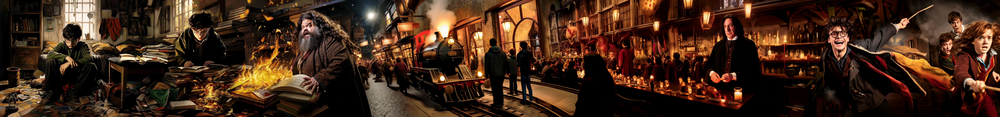

In [17]:
# Get the image dimensions
image_height, image_width, _ = image.shape

# Define the new frame step
frame_step = 3

# Calculate the amount to crop
crop_width = image_width % frame_step

# If necessary, crop the image
if crop_width != 0:
    image = image[:, :image_width-crop_width, :]

# Get the new image dimensions
image_height, image_width, _ = image.shape

# Print the new image dimensions
print(image_height, image_width)

im = Image.fromarray(image)
im

In [9]:
# Define the aspect ratio 5:4 or 16:9 or 1:1 , ...
aspect_ratio = 5 / 4

# Calculate the video width and height
video_height = image_height
video_width = int(video_height * aspect_ratio)

# Print the video dimensions
video_height, video_width


(1024, 1280)

In [10]:
# Calculate the number of frames
num_frames = (image_width - video_width) // frame_step + 1

# Print the number of frames
num_frames

2475

In [11]:
# Define the output video path
video_path = 'output.mp4'

# Create a video writer
writer = imageio.get_writer(video_path, fps=30)

# Loop over each frame
for i in range(num_frames):
    # Calculate the start and end points for the crop
    start_x = i * frame_step
    end_x = start_x + video_width

    # Crop the image
    frame = image[:, start_x:end_x, :]

    # Write the frame to the video
    writer.append_data(frame)

# Close the writer
writer.close()

# Return the video path for reference
video_path


'output.mp4'